<a href="https://nbviewer.jupyter.org/github/alisonmitchell/Stock-Prediction/blob/main/Technical_Analysis/Trading_Dashboards.ipynb" 
   target="_parent">
   <img src="https://raw.githubusercontent.com/jupyter/design/master/logos/Badges/nbviewer_badge.svg" 
      width="109" height="20" alt="render in nbviewer">
</a>

# Trading Dashboards

## 1. Introduction

Historical stock market data from Yahoo! Finance will be used to build dashboards showing various performance metrics for a single stock: AstraZeneca (EICHERMOT.NS), and a portofolio of stocks: Unilever (ULVR.L), Royal Dutch Shell (RSDB.L), GlaxoSmithKline (GSK.L), AstraZeneca (EICHERMOT.NS), HSBC (HSBA.L) and BP (BP.L).

## 2. Install/import libraries

In [72]:
!pip install yfinance
!pip install hvplot

In [73]:
import yfinance as yf

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.style as style
import seaborn as sns
import plotly.graph_objects as go
import hvplot.pandas
import holoviews as hv

import datetime
from datetime import date, timedelta

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

## 3. Download data with Yfinance API

Download historical data for Hindustan Unilever (HINDUNILVR.NS) for 2007-2023.

In [74]:
nifty_stocks = yf.download("RELIANCE.NS  BPCL.NS HINDPETRO.NS TECHM.NS INFY.NS WIPRO.NS HINDUNILVR.NS BRITANNIA.NS NESTLEIND.NS BAJAJ-AUTO.NS MARUTI.NS EICHERMOT.NS AXISBANK.NS ICICIBANK.NS HDFCBANK.NS", start=datetime.datetime(2013, 4, 1), 
                                      end=datetime.datetime(2023, 3, 31), group_by='tickers')

[*********************100%***********************]  15 of 15 completed


In [75]:
RELIANCE_historical =  yf.download('RELIANCE.NS',start=datetime.datetime(2007, 9, 17), 
                                     end=datetime.datetime(2023, 3, 31))
RELIANCE_historical.head()

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2007-09-17,502.734589,510.015564,500.505707,502.313568,450.357880,5833819
2007-09-18,500.258057,511.154755,499.242676,509.681244,456.963440,10152197
2007-09-19,528.738098,540.575867,515.104797,538.371765,482.686462,13357668
2007-09-20,538.891846,545.268921,536.662964,542.433289,486.327850,11010710
2007-09-21,540.873047,569.353088,540.266296,564.759155,506.344604,11665026


In [76]:
RELIANCE_historical

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2007-09-17,502.734589,510.015564,500.505707,502.313568,450.357880,5833819
2007-09-18,500.258057,511.154755,499.242676,509.681244,456.963440,10152197
2007-09-19,528.738098,540.575867,515.104797,538.371765,482.686462,13357668
2007-09-20,538.891846,545.268921,536.662964,542.433289,486.327850,11010710
2007-09-21,540.873047,569.353088,540.266296,564.759155,506.344604,11665026
...,...,...,...,...,...,...
2023-03-23,2268.000000,2269.899902,2243.050049,2247.800049,2247.800049,7499082
2023-03-24,2245.250000,2250.000000,2198.000000,2203.300049,2203.300049,5711497
2023-03-27,2217.500000,2254.000000,2200.199951,2237.550049,2237.550049,6486068


In [77]:
# Create DataFrame dropping all but Date and Close columns
signals_df = RELIANCE_historical.drop(columns=['Open', 'High', 'Low', 'Adj Close', 'Volume'])

## 4. Simple Moving Average Crossover Strategy

The moving average crossover trading strategy will be to take two moving averages - 50-day (fast) and 100-day (slow) - and to go long (buy) when the fast MA goes above the slow MA and to go short (sell) when the fast MA goes below the slow MA.

### 4.1 Generate moving averages and trading signals

The trading signals will be set as 0 (sell) or 1 (buy).

In [78]:
# 50 and 100 day SMA

short_window = 50
long_window = 100

# Generate the short and long moving averages (50 and 100 days, respectively)
signals_df['SMA50'] = signals_df['Close'].rolling(window=short_window).mean()
signals_df['SMA100'] = signals_df['Close'].rolling(window=long_window).mean()
signals_df['Signal'] = 0.0

# Generate the trading signal 0 or 1,
# where 0 is when the SMA50 is under the SMA100, and
# where 1 is when the SMA50 is higher (or crosses over) the SMA100
signals_df['Signal'][short_window:] = np.where(
    signals_df['SMA50'][short_window:] > signals_df['SMA100'][short_window:], 1.0, 0.0
)

# Calculate the points in time at which a position should be taken, 1 or -1
signals_df['Entry/Exit'] = signals_df['Signal'].diff()

# Print the DataFrame
signals_df.tail(10)

,Close,SMA50,SMA100,Signal,Entry/Exit
Date,,,,,
2023-03-16,2225.899902,2393.986997,2492.689006,0.0,0.0
2023-03-17,2223.100098,2388.077998,2490.121506,0.0,0.0
2023-03-20,2201.250000,2381.821997,2487.718506,0.0,0.0
2023-03-21,2269.699951,2376.477998,2485.904006,0.0,0.0
2023-03-22,2276.600098,2370.073999,2483.408508,0.0,0.0
2023-03-23,2247.800049,2363.862002,2480.390508,0.0,0.0
2023-03-24,2203.300049,2357.405005,2477.125007,0.0,0.0
2023-03-27,2237.550049,2352.724004,2474.044009,0.0,0.0
2023-03-28,2248.000000,2348.332002,2470.972510,0.0,0.0


### 4.2 Plot Moving Averages and Entry/Exit indicators

Plot the moving averages and entry/exit positions using hvPlot, an interactive Bokeh-based plotting API.

In [79]:
# Colab rendering requires reloading extension in each cell

def _render(self, **kw):
  hv.extension('bokeh')
  return hv.Store.render(self)
hv.core.Dimensioned._repr_mimebundle_ = _render

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
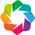

:Overlay
   .Curve.I          :Curve   [Date]   (Close)
   .NdOverlay.I      :NdOverlay   [Variable]
      :Curve   [Date]   (value)
   .Scatter.Close.I  :Scatter   [Date]   (Close)
   .Scatter.Close.II :Scatter   [Date]   (Close)

In [80]:
# Visualise exit position relative to close price
exit = signals_df[signals_df['Entry/Exit'] == -1.0]['Close'].hvplot.scatter(
    color='red',
    legend=False,
    ylabel='Price',
    marker = 'v',
    width=1000,
    height=400
)

# Visualise entry position relative to close price
entry = signals_df[signals_df['Entry/Exit'] == 1.0]['Close'].hvplot.scatter(
    color='green',
    legend=False,
    ylabel='Price',
    marker = '^',
    width=1000,
    height=400
)

# Visualise close price for the investment
security_close = signals_df[['Close']].hvplot(
    line_color='lightgray',
    ylabel='Price',
    width=1000,
    height=400
)

# Visualise moving averages
moving_avgs = signals_df[['SMA50', 'SMA100']].hvplot(
    ylabel='Price',
    width=1000,
    height=400
)

# Overlay plots
entry_exit_plot = security_close * moving_avgs * entry * exit
entry_exit_plot.opts(xaxis=None)


### 4.3 Set initial investment stake of capital and number of shares.

Here we will set £100,000 and we want to buy 500 shares of AstraZeneca.

In [81]:
# set an initial investment stake of capital and set the number of shares - here 500 shares of EICHERMOT.NS
# Set initial capital
initial_capital = float(1000000)

# Set the share size
share_size = 500

# Take a 500 share position where the dual moving average crossover is 1 (SMA50 is greater than SMA100)
signals_df['Position'] = share_size * signals_df['Signal']

# Find the points in time where a 500 share position is bought or sold
signals_df['Entry/Exit Position'] = signals_df['Position'].diff()

# Multiply share price by entry/exit positions and get the cumulatively sum
signals_df['Portfolio Holdings'] = signals_df['Close'] * signals_df['Entry/Exit Position'].cumsum()

# Subtract the initial capital by the portfolio holdings to get the amount of liquid cash in the portfolio
signals_df['Portfolio Cash'] = initial_capital - (signals_df['Close'] * signals_df['Entry/Exit Position']).cumsum()

# Get the total portfolio value by adding the cash amount by the portfolio holdings (or investments)
signals_df['Portfolio Total'] = signals_df['Portfolio Cash'] + signals_df['Portfolio Holdings']

# Calculate the portfolio daily returns
signals_df['Portfolio Daily Returns'] = signals_df['Portfolio Total'].pct_change()

# Calculate the cumulative returns
signals_df['Portfolio Cumulative Returns'] = (1 + signals_df['Portfolio Daily Returns']).cumprod() - 1

# Print the DataFrame
signals_df.tail(10)

,Close,SMA50,SMA100,Signal,Entry/Exit,Position,Entry/Exit Position,Portfolio Holdings,Portfolio Cash,Portfolio Total,Portfolio Daily Returns,Portfolio Cumulative Returns
Date,,,,,,,,,,,,
2023-03-16,2225.899902,2393.986997,2492.689006,0.0,0.0,0.0,0.0,0.0,1.146972e+06,1.146972e+06,0.0,0.146972
2023-03-17,2223.100098,2388.077998,2490.121506,0.0,0.0,0.0,0.0,0.0,1.146972e+06,1.146972e+06,0.0,0.146972
2023-03-20,2201.250000,2381.821997,2487.718506,0.0,0.0,0.0,0.0,0.0,1.146972e+06,1.146972e+06,0.0,0.146972
2023-03-21,2269.699951,2376.477998,2485.904006,0.0,0.0,0.0,0.0,0.0,1.146972e+06,1.146972e+06,0.0,0.146972
2023-03-22,2276.600098,2370.073999,2483.408508,0.0,0.0,0.0,0.0,0.0,1.146972e+06,1.146972e+06,0.0,0.146972
2023-03-23,2247.800049,2363.862002,2480.390508,0.0,0.0,0.0,0.0,0.0,1.146972e+06,1.146972e+06,0.0,0.146972
2023-03-24,2203.300049,2357.405005,2477.125007,0.0,0.0,0.0,0.0,0.0,1.146972e+06,1.146972e+06,0.0,0.146972
2023-03-27,2237.550049,2352.724004,2474.044009,0.0,0.0,0.0,0.0,0.0,1.146972e+06,1.146972e+06,0.0,0.146972
2023-03-28,2248.000000,2348.332002,2470.972510,0.0,0.0,0.0,0.0,0.0,1.146972e+06,1.146972e+06,0.0,0.146972


### 4.4 Visualise the Entry and Exit positions relative to our portfolio

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
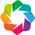

:Overlay
   .Curve.I                    :Curve   [Date]   (Portfolio Total)
   .Scatter.Portfolio_Total.I  :Scatter   [Date]   (Portfolio Total)
   .Scatter.Portfolio_Total.II :Scatter   [Date]   (Portfolio Total)

In [82]:
# Visualise exit position relative to total portfolio value
exit = signals_df[signals_df['Entry/Exit'] == -1.0]['Portfolio Total'].hvplot.scatter(
    color='red',
    legend=False,
    ylabel='Total Portfolio Value',
    width=1000,
    height=400
)

# Visualise entry position relative to total portfolio value
entry = signals_df[signals_df['Entry/Exit'] == 1.0]['Portfolio Total'].hvplot.scatter(
    color='green',
    legend=False,
    ylabel='Total Portfolio Value',
    width=1000,
    height=400
)

# Visualise total portfolio value for the investment
total_portfolio_value = signals_df[['Portfolio Total']].hvplot(
    line_color='lightgray',
    ylabel='Total Portfolio Value',
    width=1000,
    height=400
)

# Overlay plots
portfolio_entry_exit_plot = total_portfolio_value * entry * exit
portfolio_entry_exit_plot.opts(xaxis=None)

## 5. Backtesting

Before using the strategy we will evaluate the quality of it first by backtesting, or looking at how profitable it is on historical data. 

### 5.1 Define metrics
There are many indicators for measuring performance. Here we will use the following:

1.   **Cumulative return** — return on the investment in total
2.   **Annual return** — return on investment received that year
3.   **Annual volatility** — daily volatility times the square root of 252 trading days.
4.   **Sharpe ratio** — measures the performance of an investment compared to a risk-free asset, after adjusting for its risk, or in other words, the excess return relative to the risk taken.
This is the most commonly used ratio of risk-adjusted profitability. The higher the Sharpe ratio the better the strategy (>1 is desirable, <1 and >0 suggests that the risks taken might be excessive for that level of return, and <0 means that the return generated is lower than the risk-free, hence, an investment in a risk-free security provides better results. The formula is: $Sharpe$  $Ratio$  = $\frac{return - rf}{σ}$ 
5.   **Sortino ratio** — differentiates harmful volatility from total overall volatility by using the asset’s standard deviation of negative portfolio returns, downside deviation, instead of the total standard deviation of portfolio returns including positive ones (as opposed to the Sharpe ratio). A Sortino ratio of 2 is considered adequate. The formula is: $Sortino$  $Ratio$  = $\frac{return - rf}{\text{volatility } \text{of } \text{negative } \text{returns}}$ 

A good rule of thumb is to use the Sharpe ratio when evaluating low-volatility investments and the Sortino ratio for high-volatility investments.





In [83]:
# Prepare DataFrame for metrics
metrics = [
    'Annual Return',
    'Cumulative Returns',
    'Annual Volatility',
    'Sharpe Ratio',
    'Sortino Ratio']

columns = ['Backtest']

# Initialise the DataFrame with index set to evaluation metrics and column as 'Backtest' 
portfolio_evaluation_df = pd.DataFrame(index=metrics, columns=columns)
portfolio_evaluation_df

,Backtest
Annual Return,NaN
Cumulative Returns,NaN
Annual Volatility,NaN
Sharpe Ratio,NaN
Sortino Ratio,NaN


### 5.2 Perform Backtest

Calculate metrics for indicators.

In [84]:
# Calculate cumulative return
portfolio_evaluation_df.loc['Cumulative Returns'] = signals_df['Portfolio Cumulative Returns'][-1]

# Calculate annualised return
portfolio_evaluation_df.loc['Annual Return'] = (
    signals_df['Portfolio Daily Returns'].mean() * 252
)

# Calculate annual volatility
portfolio_evaluation_df.loc['Annual Volatility'] = (
    signals_df['Portfolio Daily Returns'].std() * np.sqrt(252)
)

# Calculate Sharpe Ratio
portfolio_evaluation_df.loc['Sharpe Ratio'] = (
    signals_df['Portfolio Daily Returns'].mean() * 252) / (
    signals_df['Portfolio Daily Returns'].std() * np.sqrt(252)
)

# Calculate Downside Return
sortino_ratio_df = signals_df[['Portfolio Daily Returns']].copy()
sortino_ratio_df.loc[:,'Downside Returns'] = 0

target = 0
mask = sortino_ratio_df['Portfolio Daily Returns'] < target
sortino_ratio_df.loc[mask, 'Downside Returns'] = sortino_ratio_df['Portfolio Daily Returns']**2
portfolio_evaluation_df

# Calculate Sortino Ratio
down_stdev = np.sqrt(sortino_ratio_df['Downside Returns'].mean()) * np.sqrt(252)
expected_return = sortino_ratio_df['Portfolio Daily Returns'].mean() * 252
sortino_ratio = expected_return/down_stdev

portfolio_evaluation_df.loc['Sortino Ratio'] = sortino_ratio
portfolio_evaluation_df.head()

,Backtest
Annual Return,0.013744
Cumulative Returns,0.146972
Annual Volatility,0.097184
Sharpe Ratio,0.14142
Sortino Ratio,0.204567


In [85]:
# Initialise trade evaluation DataFrame with columns
trade_evaluation_df = pd.DataFrame(
    columns=[
        'Stock', 
        'Entry Date', 
        'Exit Date', 
        'Shares', 
        'Entry Share Price', 
        'Exit Share Price', 
        'Entry Portfolio Holding', 
        'Exit Portfolio Holding', 
        'Profit/Loss']
)

trade_evaluation_df

,Stock,Entry Date,Exit Date,Shares,Entry Share Price,Exit Share Price,Entry Portfolio Holding,Exit Portfolio Holding,Profit/Loss


In [86]:
# Initialise iterative variables
entry_date = ''
exit_date = ''
entry_portfolio_holding = 0
exit_portfolio_holding = 0
share_size = 0
entry_share_price = 0
exit_share_price = 0

# Loop through signal DataFrame
# If 'Entry/Exit' is 1, set entry trade metrics
# Else if 'Entry/Exit' is -1, set exit trade metrics and calculate profit,
# Then append the record to the trade evaluation DataFrame
for index, row in signals_df.iterrows():
    if row['Entry/Exit'] == 1:
        entry_date = index
        entry_portfolio_holding = abs(row['Portfolio Holdings'])
        share_size = row['Entry/Exit Position']
        entry_share_price = row['Close']

    elif row['Entry/Exit'] == -1:
        exit_date = index
        exit_portfolio_holding = abs(row['Close'] * row['Entry/Exit Position'])
        exit_share_price = row['Close']
        profit_loss =  entry_portfolio_holding - exit_portfolio_holding
        trade_evaluation_df = trade_evaluation_df.append(
            {
                'Stock': 'RELIANCE.NS',
                'Entry Date': entry_date,
                'Exit Date': exit_date,
                'Shares': share_size,
                'Entry Share Price': entry_share_price,
                'Exit Share Price': exit_share_price,
                'Entry Portfolio Holding': entry_portfolio_holding,
                'Exit Portfolio Holding': exit_portfolio_holding,
                'Profit/Loss': profit_loss
            },
            ignore_index=True)

# Print the DataFrame
trade_evaluation_df

,Stock,Entry Date,Exit Date,Shares,Entry Share Price,Exit Share Price,Entry Portfolio Holding,Exit Portfolio Holding,Profit/Loss
0,RELIANCE.NS,2008-02-07,2008-02-22,500.0,600.668762,602.897644,3.003344e+05,3.014488e+05,-1114.440918
1,RELIANCE.NS,2008-06-10,2008-07-03,500.0,544.278259,512.665466,2.721391e+05,2.563327e+05,15806.396484
2,RELIANCE.NS,2009-03-13,2009-08-24,500.0,318.047729,488.940338,1.590239e+05,2.444702e+05,-85446.304321
3,RELIANCE.NS,2009-10-13,2010-02-19,500.0,535.424683,486.983887,2.677123e+05,2.434919e+05,24220.397949
4,RELIANCE.NS,2010-05-06,2010-06-23,500.0,499.193146,524.379395,2.495966e+05,2.621897e+05,-12593.124390
5,RELIANCE.NS,2010-11-10,2011-01-21,500.0,545.925171,488.766968,2.729626e+05,2.443835e+05,28579.101562
6,RELIANCE.NS,2011-04-29,2011-06-13,500.0,487.256287,458.454315,2.436281e+05,2.292272e+05,14400.985718
7,RELIANCE.NS,2011-11-15,2012-01-03,500.0,426.680481,358.922760,2.133402e+05,1.794614e+05,33878.860474
8,RELIANCE.NS,2012-03-19,2012-05-02,500.0,374.004822,368.284027,1.870024e+05,1.841420e+05,2860.397339
9,RELIANCE.NS,2012-08-08,2013-04-10,500.0,391.687195,386.040710,1.958436e+05,1.930204e+05,2823.242188


### 5.3 Plot results of backtest

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
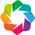

:NdOverlay   [Variable]
   :Curve   [Date]   (value)

In [87]:
price_df = signals_df[['Close', 'SMA50', 'SMA100']]
price_chart = price_df.hvplot.line()
price_chart.opts(title='RELIANCE.NS',xaxis=None)

### 5.4 Print dashboard

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
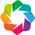

:Table   [index,Backtest]

In [88]:
portfolio_evaluation_df.reset_index(inplace=True)
portfolio_evaluation_table = portfolio_evaluation_df.hvplot.table()
portfolio_evaluation_table

## 6. Trading Dashboard using multiple stock tickers

### 6.1 Data collection 

Read in Nifty50 stock data downloaded from Yahoo! Finance using yfinance API into a pandas dataframe. The stocks chosen are TECHM.NS INFY.NS HINDUNILVR.NS BAJAJ-AUTO.NS MARUTI.NS EICHERMOT.NS HINDUNILVR.NS BRITANNIA.NS NESTLEIND.NS AXISBANK.NS ICICIBANK.NS HDFCBANK.NS.

In [89]:
nifty50_stocks = yf.download("RELIANCE.NS  BPCL.NS HINDPETRO.NS TECHM.NS INFY.NS WIPRO.NS HINDUNILVR.NS BRITANNIA.NS NESTLEIND.NS BAJAJ-AUTO.NS MARUTI.NS EICHERMOT.NS AXISBANK.NS ICICIBANK.NS HDFCBANK.NS", start=datetime.datetime(2013, 4, 1), 
                                      end=datetime.datetime(2023, 3, 31), group_by='tickers')

[*********************100%***********************]  15 of 15 completed


In [90]:
RELIANCE_historical =  nifty50_stocks['RELIANCE.NS']
BPCL_historical =  nifty50_stocks['BPCL.NS']
HPCL_historical =  nifty50_stocks['HINDPETRO.NS']
BRITANNIA_historical =  nifty50_stocks['BRITANNIA.NS']
NESTLEIND_historical =  nifty50_stocks['NESTLEIND.NS']
HINDUNILVR_historical =  nifty50_stocks['HINDUNILVR.NS']
TECHM_historical =  nifty50_stocks['TECHM.NS']
INFY_historical =  nifty50_stocks['INFY.NS']
WIPRO_historical =  nifty50_stocks['WIPRO.NS']

In [91]:
# DataFrame of the closing price of selected stocks

nifty_stocks_close = pd.DataFrame({
                                "RELIANCE.NS": RELIANCE_historical.Close,
                                "BPCL.NS": BPCL_historical.Close,
                                "HINDPETRO.NS": HPCL_historical.Close,
                                "BRITANNIA.NS": BRITANNIA_historical.Close,
                                "NESTLEIND.NS": NESTLEIND_historical.Close,
                                "HINDUNILVR.NS": HINDUNILVR_historical.Close,
                                "TECHM.NS": TECHM_historical.Close,
                                "INFY.NS": INFY_historical.Close,
                                "WIPRO.NS": WIPRO_historical.Close
                                })
nifty_stocks_close.head()

,RELIANCE.NS,BPCL.NS,HINDPETRO.NS,BRITANNIA.NS,NESTLEIND.NS,HINDUNILVR.NS,TECHM.NS,INFY.NS,WIPRO.NS
Date,,,,,,,,,
2013-04-01,385.718781,125.666664,62.888889,263.725006,4622.850098,471.350006,265.287506,368.024994,161.625046
2013-04-02,393.222656,125.900002,63.555553,264.000000,4622.049805,470.899994,256.549988,371.131256,168.618790
2013-04-03,384.629089,125.000000,62.855556,259.975006,4645.899902,462.799988,244.262497,371.056244,168.225037
2013-04-04,380.171356,123.183334,62.111111,256.500000,4552.600098,470.049988,244.250000,360.006256,166.912537
2013-04-05,386.387421,125.500000,63.133331,258.325012,4454.299805,471.700012,240.462494,358.231262,170.475037


## 7. Calculate daily returns

### 7.1 Data transformation 

To be able to plot the daily stock returns we will transform the data by calculating the daily percentage change directly using the pandas **'pct_change()'** method which computes the percentage change from the previous row by default.



In [92]:
# Create dataframe to contain returns for each company's stock to plot the change of each stock per day

returns = pd.DataFrame()

In [93]:
# pandas pct_change() method on the Close column to create a column representing return value

tickers = ['RELIANCE.NS',  'BPCL.NS','INFY.NS', 'WIPRO.NS' ,'HINDUNILVR.NS', 'BRITANNIA.NS','BAJAJ-AUTO.NS' ,'MARUTI.NS','ICICIBANK.NS', 'HDFCBANK.NS']
for ticker in tickers:
    returns[ticker] = nifty50_stocks[ticker].Close.pct_change() * 100

returns

,RELIANCE.NS,BPCL.NS,INFY.NS,WIPRO.NS,HINDUNILVR.NS,BRITANNIA.NS,BAJAJ-AUTO.NS,MARUTI.NS,ICICIBANK.NS,HDFCBANK.NS
Date,,,,,,,,,,
2013-04-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-04-02,1.945427,0.185680,0.844036,4.327141,-0.095473,0.104273,-1.605574,1.869450,-0.442199,0.969792
2013-04-03,-2.185420,-0.714854,-0.020212,-0.233517,-1.720112,-1.524619,-3.443258,-0.328800,-1.480567,-0.992221
2013-04-04,-1.158969,-1.453333,-2.977982,-0.780205,1.566551,-1.336669,-1.107927,0.583044,-2.191193,-1.202598
2013-04-05,1.635069,1.880665,-0.493045,2.134351,0.351032,0.711506,1.652129,7.261084,-1.055714,0.779029
...,...,...,...,...,...,...,...,...,...,...
2023-03-23,-1.265046,-0.980666,-1.058121,-1.337335,0.353343,-0.041230,-1.554556,1.221460,-0.552197,-0.802768
2023-03-24,-1.979713,-0.846853,0.443780,0.069156,-0.173033,-1.007613,-0.907339,-1.320450,-0.356536,-0.159933
2023-03-27,1.554486,-0.159232,0.601161,-0.138217,0.733632,0.353566,-0.531619,0.430058,-0.434070,0.435711


In [94]:
# Clean up the data by dropping the first value which becomes a 'NaN' as there is no price change from the day before.

returns.dropna(inplace=True)
returns.head()

,RELIANCE.NS,BPCL.NS,INFY.NS,WIPRO.NS,HINDUNILVR.NS,BRITANNIA.NS,BAJAJ-AUTO.NS,MARUTI.NS,ICICIBANK.NS,HDFCBANK.NS
Date,,,,,,,,,,
2013-04-02,1.945427,0.185680,0.844036,4.327141,-0.095473,0.104273,-1.605574,1.869450,-0.442199,0.969792
2013-04-03,-2.185420,-0.714854,-0.020212,-0.233517,-1.720112,-1.524619,-3.443258,-0.328800,-1.480567,-0.992221
2013-04-04,-1.158969,-1.453333,-2.977982,-0.780205,1.566551,-1.336669,-1.107927,0.583044,-2.191193,-1.202598
2013-04-05,1.635069,1.880665,-0.493045,2.134351,0.351032,0.711506,1.652129,7.261084,-1.055714,0.779029
2013-04-08,1.192159,1.049136,-1.184647,-1.275839,1.324995,0.454849,0.246874,0.984852,-0.906673,0.563652


### 7.2 Plot Daily returns

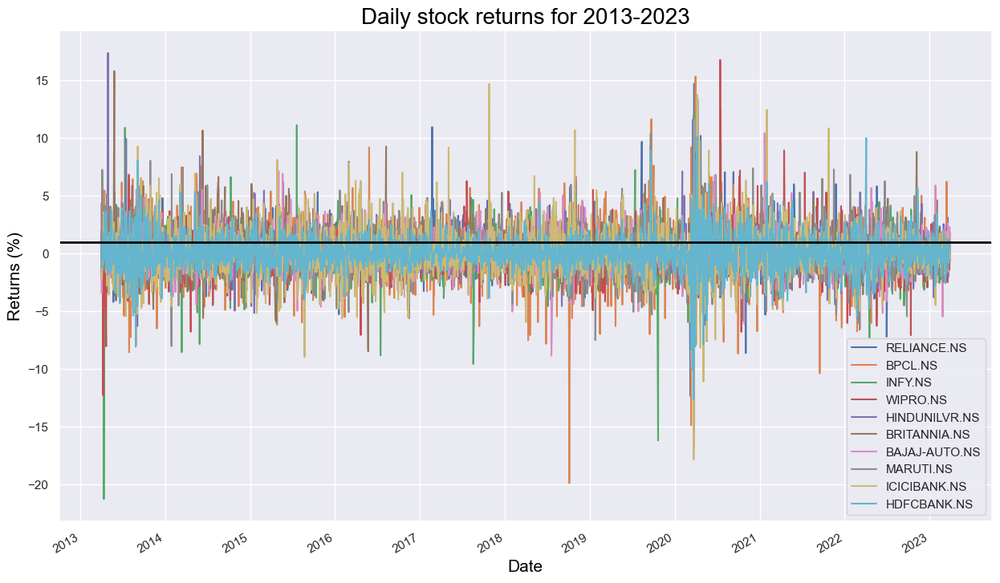

In [95]:
# Plot returns for 2013-2013

returns.plot(grid = True).axhline(y = 1, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 15)})
plt.title('Daily stock returns for 2013-2023', color = 'black', fontsize = 20)
plt.xlabel('Date', color = 'black', fontsize = 15)
plt.ylabel('Returns (%)', color = 'black', fontsize = 15);

## 8. Cumulative returns

The cumulative return is the aggregate amount that the investment has gained or lost over time, independent of the amount of time involved. It is expressed as a percentage, and is the raw mathematical return of the following calculation:

$\frac{\text {Current } \text {Price } \text{of } \text{Security} - \text {Original } \text {Price } \text{of } \text{Security} }{\text{Original } \text{Price } \text{of } \text{Security}}$ 



​	

### 8.1 Calculate cumulative returns

In [96]:
# Calculate cumulative returns

cumulative_returns = (1 + (returns / 100)).cumprod()

cumulative_returns.head()

,RELIANCE.NS,BPCL.NS,INFY.NS,WIPRO.NS,HINDUNILVR.NS,BRITANNIA.NS,BAJAJ-AUTO.NS,MARUTI.NS,ICICIBANK.NS,HDFCBANK.NS
Date,,,,,,,,,,
2013-04-02,1.019454,1.001857,1.008440,1.043271,0.999045,1.001043,0.983944,1.018694,0.995578,1.009698
2013-04-03,0.997175,0.994695,1.008237,1.040835,0.981861,0.985781,0.950065,1.015345,0.980838,0.999679
2013-04-04,0.985618,0.980239,0.978211,1.032715,0.997242,0.972604,0.939538,1.021265,0.959346,0.987657
2013-04-05,1.001733,0.998674,0.973388,1.054756,1.000743,0.979524,0.955061,1.095420,0.949218,0.995352
2013-04-08,1.013676,1.009151,0.961857,1.041299,1.014002,0.983980,0.957419,1.106208,0.940612,1.000962


### 8.2 Plot cumulative returns

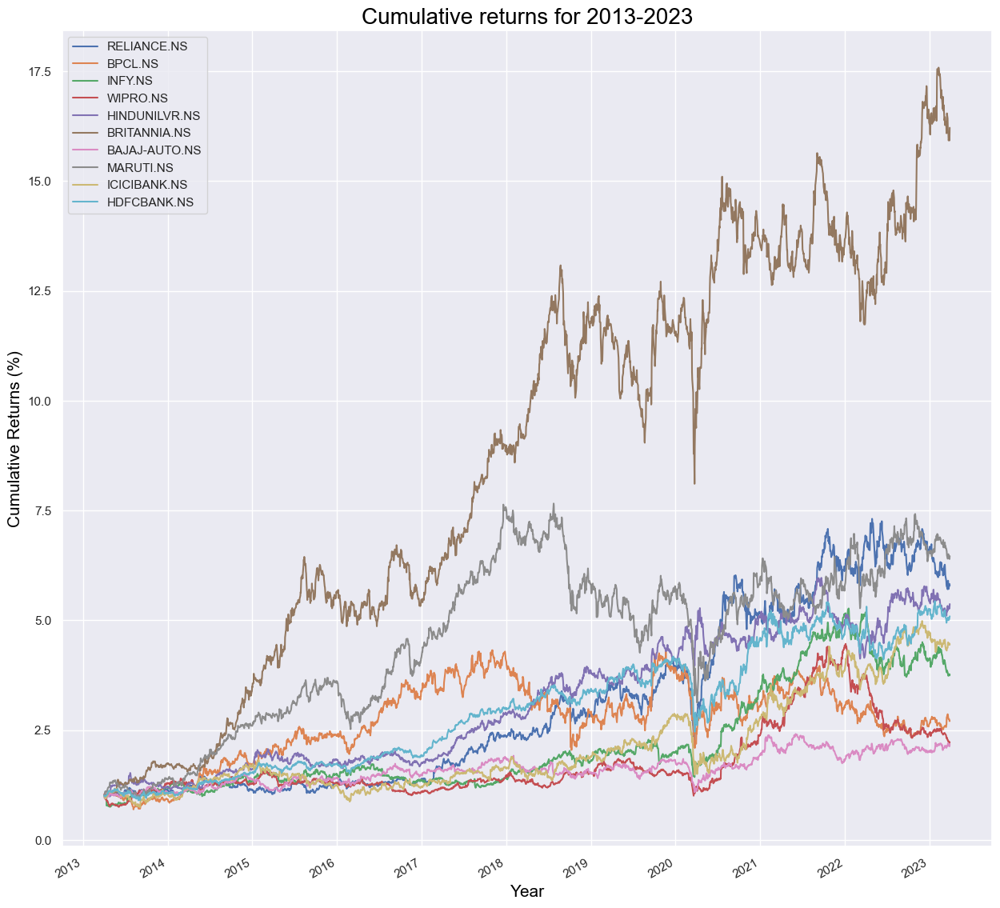

In [97]:
# Plot cumulative returns

cumulative_returns.plot(grid = True)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Cumulative returns for 2013-2023', color = 'black', fontsize = 20)
plt.xlabel('Year', color = 'black', fontsize = 15)
plt.ylabel('Cumulative Returns (%)', color = 'black', fontsize = 15);

## 9. Calculate standard deviation

Standard deviation (σ) is often used by investors to measure the risk of a stock or a stock portfolio, the basic idea being that it is a measure of volatility, or the spread of asset prices from the mean. The higher the volatility, the higher the standard deviation and the riskier the investment, the lower the standard deviation the lower the risk.

In [98]:
# Calculate daily standard deviation for each stock

returns = returns / 100

returns.std()

RELIANCE.NS      0.018002
BPCL.NS          0.022482
INFY.NS          0.017472
WIPRO.NS         0.016455
HINDUNILVR.NS    0.015236
BRITANNIA.NS     0.016772
BAJAJ-AUTO.NS    0.016040
MARUTI.NS        0.018340
ICICIBANK.NS     0.021102
HDFCBANK.NS      0.014957
dtype: float64

In [99]:
# Calculate the annualised standard deviation (252 trading days)

returns.std() * np.sqrt(252)

RELIANCE.NS      0.285770
BPCL.NS          0.356890
INFY.NS          0.277356
WIPRO.NS         0.261222
HINDUNILVR.NS    0.241866
BRITANNIA.NS     0.266244
BAJAJ-AUTO.NS    0.254631
MARUTI.NS        0.291144
ICICIBANK.NS     0.334981
HDFCBANK.NS      0.237441
dtype: float64

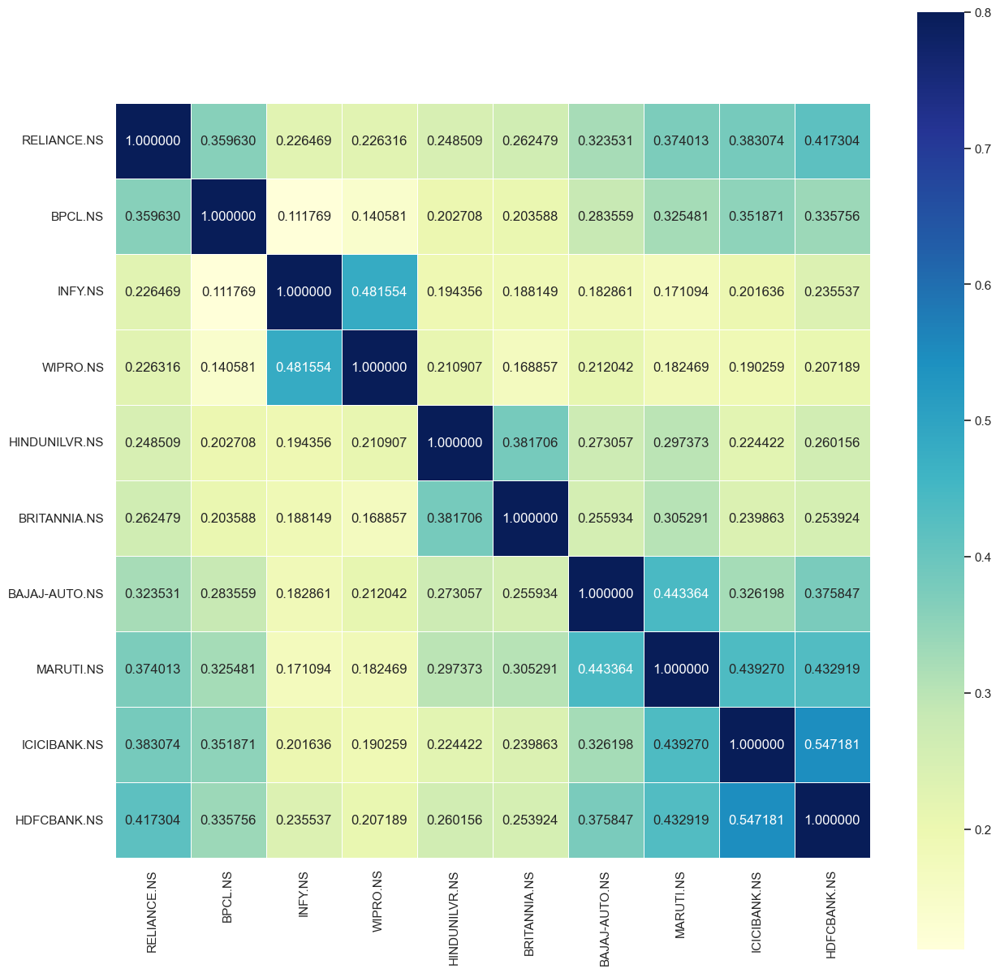

In [100]:
# Plot correlation heatmap

plt.figure(figsize=(15, 15))
sns.heatmap(data = returns.corr(), vmax=.8, linewidths=0.5,  fmt='.6f',
            square=True,annot=True,cmap='YlGnBu',linecolor="white")
plt.show()

The bank stocks, AXISBANK.NS and ICICIBANK.NS, show the highest correlation.

## 10. Exponentially Weighted Moving Average

We will calculate and plot the daily returns using an Exponentially Weighted Moving Average where past values have a diminishing contribution to the average, while more recent values have a greater contribution.

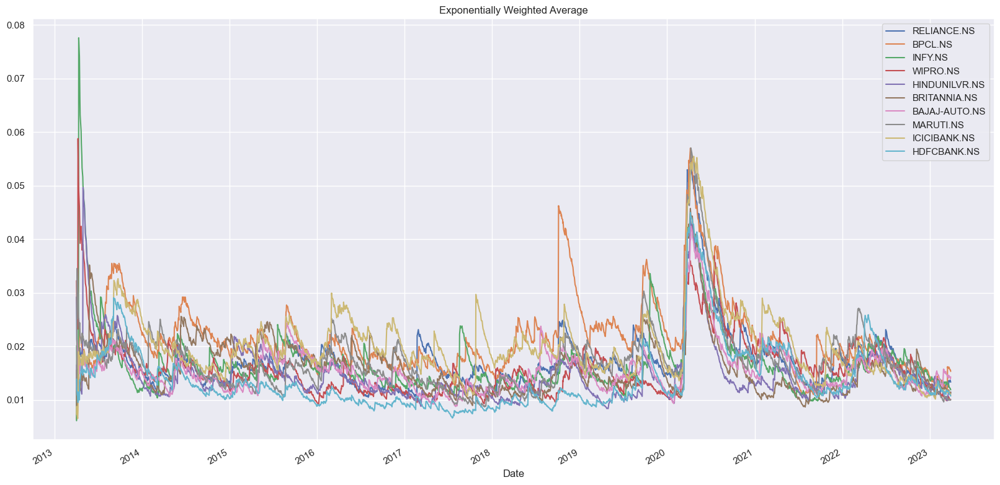

In [101]:
# Calculate a rolling window using the Exponentially Weighted Moving Average. 
returns.ewm(halflife=21).std().plot(figsize=(20, 10), title="Exponentially Weighted Average"); 

## 11. Plot Sharpe Ratios

The Sharpe ratio measures the performance of an investment compared to a risk-free asset, after adjusting for its risk. To calculate it you take the return, subtract the risk-free rate and divide by the volatility of said investment’s returns.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
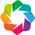

:Bars   [index]   (0)

In [102]:
# Calculate annualised Sharpe Ratios
sharpe_ratios = (returns.mean() * 252) / (returns.std() * np.sqrt(252))
# Visualise the sharpe ratios as a bar plot
sharpe_ratios.hvplot.barh(figsize=(15, 8), title="Sharpe Ratios", color= 'red')

For our portfolio the Sharpe ratios are very low. A ratio under 1.0 is considered sub-optimal and the risks taken might be excessive for that level of return.

A negative Sharpe ratio means that the investment return is lower than the risk-free rate, which appears to be the case for HSBA.L, RDSB.L, and BP.L, so investment in a risk-free security would have provided better results.  However, negative Sharpe ratios won't persist for indefinite periods of time, and looking at a wider date range would likely show positive Sharpe ratios for these assets.



## 12. Backtesting
Before using the strategy we will evaluate the quality of it first by backtesting, or looking at how profitable it is on historical data.

### 12.1 Prepare dataframe for metrics

In [103]:
# Prepare DataFrame for metrics

metrics = [
    'RELIANCE.NS Annual Return','BPCL.NS Annual Return','BRITANNIA.NS Annual Return', 'HINDUNILVR.NS Annual Return','BAJAJ-AUTO.NS Annual Return','MARUTI.NS Annual Return', 'INFY.NS Annual Return','WIPRO.NS Annual Return','ICICIBANK.NS Annual Return','HDFCBANK.NS Annual Return',
    'RELIANCE.NS Annual Votality','BPCL.NS Annual Votality','BRITANNIA.NS Annual Votality', 'HINDUNILVR.NS Annual Votality','BAJAJ-AUTO.NS Annual Votality','MARUTI.NS Annual Votality', 'INFY.NS Annual Votality','WIPRO.NS Annual Votality','ICICIBANK.NS Annual Votality','HDFCBANK.NS Annual Votality',
    'RELIANCE.NS Sharp Ratio','BPCL.NS Sharp Ratio','BRITANNIA.NS Sharp Ratio', 'HINDUNILVR.NS Sharp Ratio','BAJAJ-AUTO.NS Sharp Ratio','MARUTI.NS Sharp Ratio', 'INFY.NS Sharp Ratio','WIPRO.NS Sharp Ratio','ICICIBANK.NS Sharp Ratio','HDFCBANK.NS Sharp Ratio']
columns = ['Backtest']

# Initialise the DataFrame with index set to evaluation metrics and column as 'Backtest'.

portfolio_evaluation_df = pd.DataFrame(index=metrics, columns=columns)
portfolio_evaluation_df

,Backtest
RELIANCE.NS Annual Return,NaN
BPCL.NS Annual Return,NaN
BRITANNIA.NS Annual Return,NaN
HINDUNILVR.NS Annual Return,NaN
BAJAJ-AUTO.NS Annual Return,NaN
MARUTI.NS Annual Return,NaN
INFY.NS Annual Return,NaN
WIPRO.NS Annual Return,NaN
ICICIBANK.NS Annual Return,NaN
HDFCBANK.NS Annual Return,NaN


### 12.2 Perform backtest

Calculate metrics for indicators.

In [104]:
# Calculate annualised return
portfolio_evaluation_df.loc['RELIANCE.NS Annual Return'] = returns['RELIANCE.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['BPCL.NS Annual Return'] = returns['BPCL.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['BRITANNIA.NS Annual Return'] = returns['BRITANNIA.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['HINDUNILVR.NS Annual Return'] = returns['HINDUNILVR.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['BAJAJ-AUTO.NS Annual Return'] = returns['BAJAJ-AUTO.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['MARUTI.NS Annual Return'] = returns['MARUTI.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['INFY.NS Annual Return'] = returns['INFY.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['WIPRO.NS Annual Return'] = returns['WIPRO.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['ICICIBANK.NS Annual Return'] = returns['ICICIBANK.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['HDFCBANK.NS Annual Return'] = returns['HDFCBANK.NS'].std() * np.sqrt(252)
# #Calculate annual volatility
portfolio_evaluation_df.loc['RELIANCE.NS Annual Votality'] = returns['RELIANCE.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['BPCL.NS Annual Votality'] = returns['BPCL.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['BRITANNIA.NS Annual Votality'] = returns['BRITANNIA.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['HINDUNILVR.NS Annual Votality'] = returns['HINDUNILVR.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['BAJAJ-AUTO.NS Annual Votality'] = returns['BAJAJ-AUTO.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['MARUTI.NS Annual Votality'] = returns['MARUTI.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['INFY.NS Annual Votality'] = returns['INFY.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['WIPRO.NS Annual Votality'] = returns['WIPRO.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['ICICIBANK.NS Annual Votality'] = returns['ICICIBANK.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['HDFCBANK.NS Annual Votality'] = returns['HDFCBANK.NS'].std() * np.sqrt(252)
# Calculate Sharpe Ratio
portfolio_evaluation_df.loc['RELIANCE.NS Sharp Ratio'] = returns['RELIANCE.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['BPCL.NS Sharp Ratio'] = returns['BPCL.NS'].std() * np.sqrt(252)
portfolio_evaluation_df.loc['BRITANNIA.NS Sharp Ratio'] = sharpe_ratios['BRITANNIA.NS']
portfolio_evaluation_df.loc['HINDUNILVR.NS Sharp Ratio'] = sharpe_ratios['HINDUNILVR.NS']
portfolio_evaluation_df.loc['BAJAJ-AUTO.NS Sharp Ratio'] = sharpe_ratios['BAJAJ-AUTO.NS']
portfolio_evaluation_df.loc['MARUTI.NS Sharp Ratio'] = sharpe_ratios['MARUTI.NS']
portfolio_evaluation_df.loc['INFY.NS Sharp Ratio'] = sharpe_ratios['INFY.NS']
portfolio_evaluation_df.loc['WIPRO.NS Sharp Ratio'] = sharpe_ratios['WIPRO.NS']
portfolio_evaluation_df.loc['ICICIBANK.NS Sharp Ratio'] = sharpe_ratios['ICICIBANK.NS']
portfolio_evaluation_df.loc['HDFCBANK.NS Sharp Ratio'] = sharpe_ratios['HDFCBANK.NS']
portfolio_evaluation_df.head(36)

,Backtest
RELIANCE.NS Annual Return,0.28577
BPCL.NS Annual Return,0.35689
BRITANNIA.NS Annual Return,0.266244
HINDUNILVR.NS Annual Return,0.241866
BAJAJ-AUTO.NS Annual Return,0.254631
MARUTI.NS Annual Return,0.291144
INFY.NS Annual Return,0.277356
WIPRO.NS Annual Return,0.261222
ICICIBANK.NS Annual Return,0.334981
HDFCBANK.NS Annual Return,0.237441


### 12.3 Print dashboard

In [105]:
portfolio_evaluation_df.reset_index(inplace=True)
portfolio_evaluation_table = portfolio_evaluation_df.hvplot.table()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
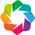

:Table   [index,Backtest]

In [106]:
portfolio_evaluation_table